In [2]:
import zarr
from pathlib import Path

import numpy as np
import pandas as pd
import anndata
import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import squidpy as sq
import spatialdata

Load data

In [3]:
adata = anndata.read_h5ad("../Prot_sopa/protein_adata/Up_Slide_14.h5ad")

Normalise Data

In [4]:
divider = (5 * np.quantile(adata.X, 0.2, axis=0))
divider[divider == 0] = adata.X.max(axis=0)[divider == 0]

In [5]:
scaled = np.arcsinh(adata.X / divider)

adata.X = (scaled - scaled.mean(0)) / scaled.std(0)

In [5]:
adata

AnnData object with n_obs × n_vars = 127771 × 69
    obs: 'region', 'slide', 'cell_id', 'area', 'ID'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial'
    layers: 'counts'

In [126]:
adata.var_names

Index(['p53', 'CD31', 'Vimentin', 'CD19', 'Membrane', 'STING', '4-1BB',
       'LAMP1', 'LAG3', 'PanCK', 'DNA', 'CD34', 'IgD', 'IL-18', 'CD40', 'CD45',
       'ICAM1', 'CD138', 'Beta-catenin', 'Fibronectin', 'EGFR', 'ICOS',
       'FABP4', 'CD123', 'CD14', 'CD45 (1)', 'GZMB', 'Bcl-2', 'PD-1', 'iNOS',
       'CD4', 'Her2', 'CD127', 'GITR', 'CD56', 'Ms IgG1', 'CCR7', 'pan-RAS',
       'Tim-3', 'IL-1b', 'CD3', 'CD163', 'SMA', 'CD27', 'VISTA', 'Ki-67',
       'PD-L2', 'Rb IgG', 'CD11c', 'EpCAM', 'CD45RA', 'GZMA', 'FOXP3', 'CD15',
       'PD-L1', 'NF-kB p65', 'B7-H3', 'CD68', 'TCF7', 'CD11b', 'CD8', 'CD16',
       'CTLA4', 'HLA-DR', 'CD39', 'CD38', 'CD20', 'CD68 (1)', 'IDO1'],
      dtype='object')

In [6]:
#  Remove IgG and DNA & Membrane, double CD45 and CD68
Genes_keep = [ 'p53', 'CD31', 'Vimentin', 'CD19',  'STING', '4-1BB',
       'LAMP1', 'LAG3', 'PanCK', 'CD34', 'IgD', 'IL-18', 'CD40',
       'ICAM1', 'CD138', 'Beta-catenin', 'Fibronectin', 'EGFR', 'ICOS',
       'FABP4', 'CD123', 'CD14', 'CD45 (1)', 'GZMB', 'Bcl-2', 'PD-1', 'iNOS',
       'CD4', 'Her2', 'CD127', 'GITR', 'CD56',  'CCR7', 'pan-RAS',
       'Tim-3', 'IL-1b', 'CD3', 'CD163', 'SMA', 'CD27', 'VISTA', 'Ki-67',
       'PD-L2',  'CD11c', 'EpCAM', 'CD45RA', 'GZMA', 'FOXP3', 'CD15',
       'PD-L1', 'NF-kB p65', 'B7-H3', 'TCF7', 'CD11b', 'CD8', 'CD16',
       'CTLA4', 'HLA-DR', 'CD39', 'CD38', 'CD20', 'CD68 (1)', 'IDO1']


adata = adata[:, Genes_keep]

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Run Umap and Clustering

In [7]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata, min_dist= 0.2)
sc.tl.leiden(adata, resolution=0.8)

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm




Failed to import TF-Keras. Please note that TF-Keras is not installed by default when you install TensorFlow Probability. This is so that JAX-only users do not have to install TensorFlow or TF-Keras. To use TensorFlow Probability with TensorFlow, please install the tf-keras or tf-keras-nightly package.
This can be be done through installing the tensorflow-probability[tf] extra.




OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


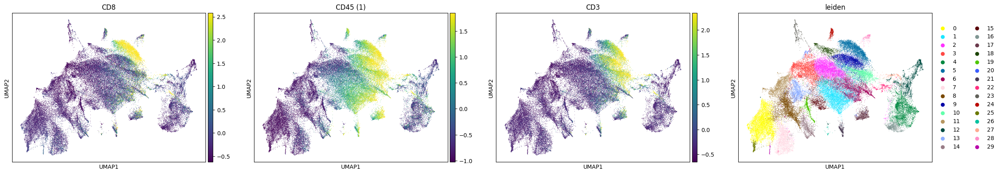

In [8]:
sc.pl.umap(adata, color= ["CD8","CD45 (1)","CD3","leiden"], vmax="p95",vmin="p5", cmap="viridis")

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


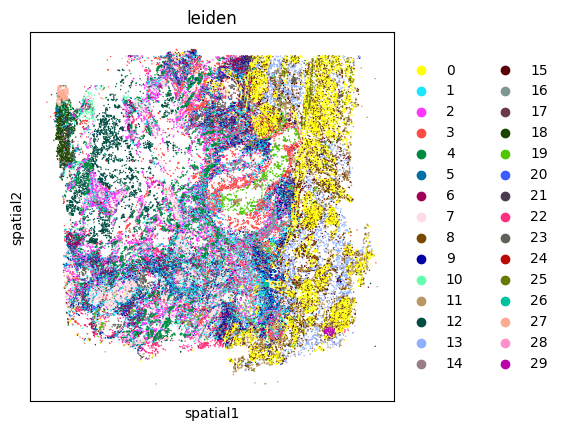

In [9]:
sc.pl.spatial(adata, color = "leiden", spot_size= 200)

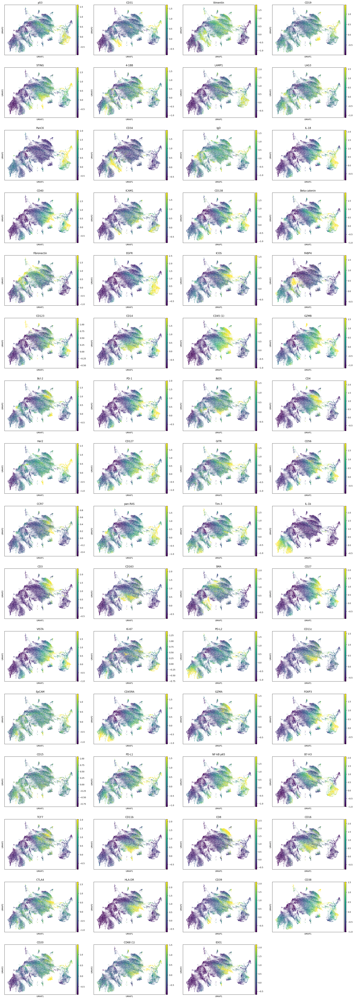

In [10]:
sc.pl.umap(adata, color=adata.var_names, vmin="p05",vmax="p95")

Run Differential expressed proteins

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in

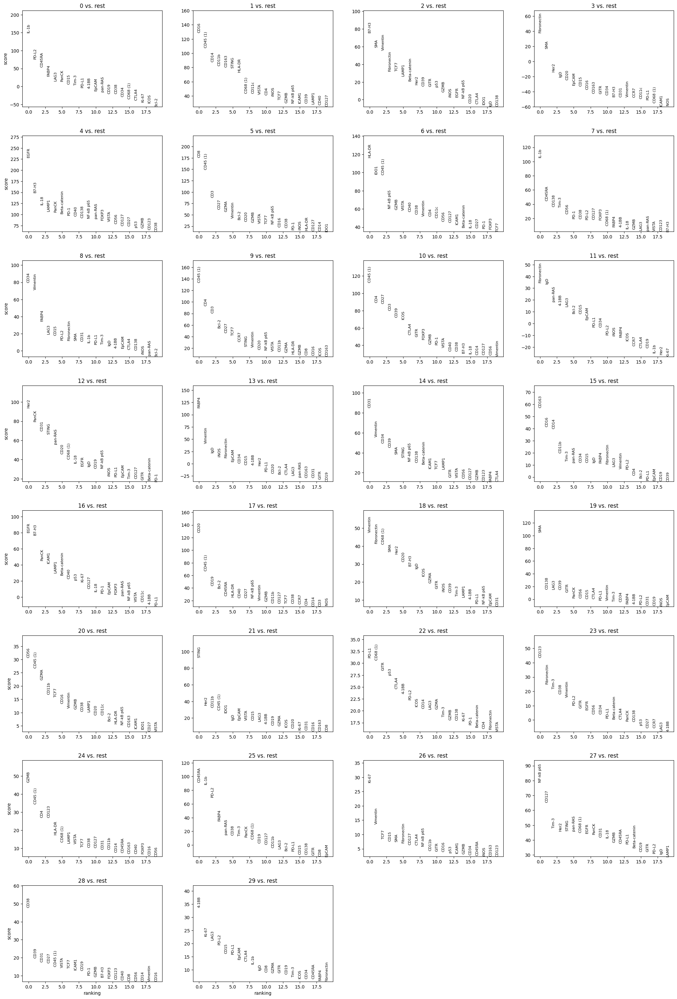

In [12]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

In [49]:
adata.obs["annot_level0"] = (
    adata.obs["leiden"]
    .map(lambda x: {"0": "Muscle cells", "1": "MNP", "2": "Stromal","3": "Endothelials",
                    "4": "Tumour", "5": "T cell","6": "MNP","7": "Muscle cells","8": "Stromal"
                    ,"9": "T cell","10": "T cell","11": "Stromal","12": "Tumour", 
                    "13": "Adipocytes","14": "Endothelials","15":"MNP","16":"Tumour","17":"B cell","18":"Autofluo/collagen","19":"Stromal","20":"NK cell","21":"STING cell",
                    "22" : "MNP", "23":"Nerves","24":"T cell","25":"Muscle cells","26":"Tumour", "27" :"Tumour" , "28" : "B cell","29" : "RBC"}.get(x, x))
    .astype("category")
)

Extract immune for annotation

In [17]:
immune_adata = adata[adata.obs["annot_level0"].isin(["T cell","MNP","NK cell","B cell","Neutro?","STING cell"])]

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [18]:
sc.pp.pca(immune_adata)
sc.pp.neighbors(immune_adata)
sc.tl.umap(immune_adata, min_dist= 0.2)
sc.tl.leiden(immune_adata, resolution=1.2)

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


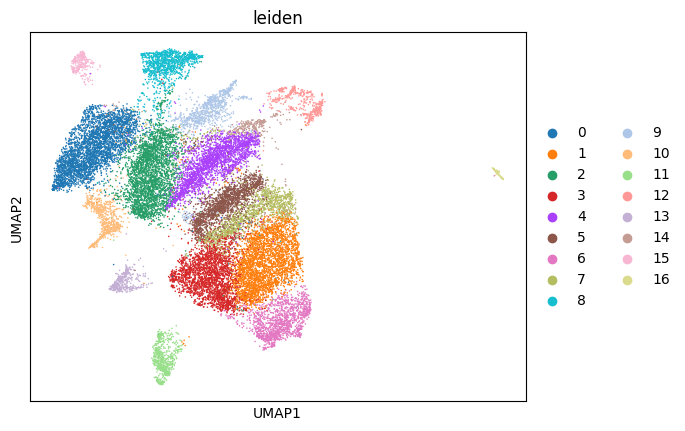

In [24]:
sc.pl.umap(immune_adata, color="leiden")

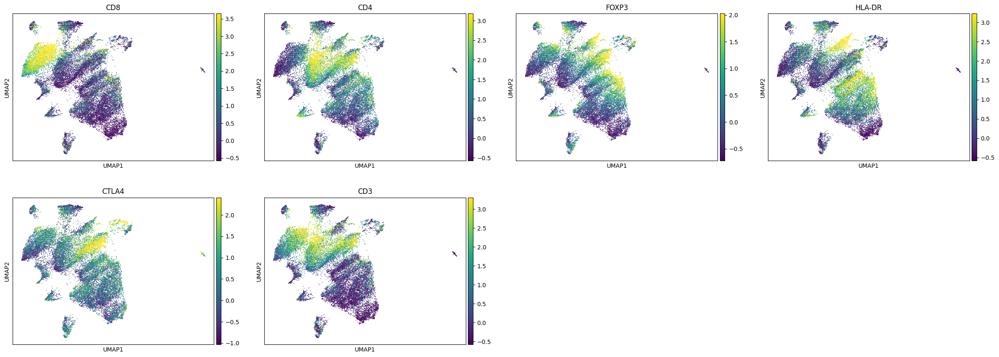

In [21]:
sc.pl.umap(immune_adata, color=["CD8","CD4","FOXP3","HLA-DR","CTLA4","CD3"], vmin="p05",vmax="p95")

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


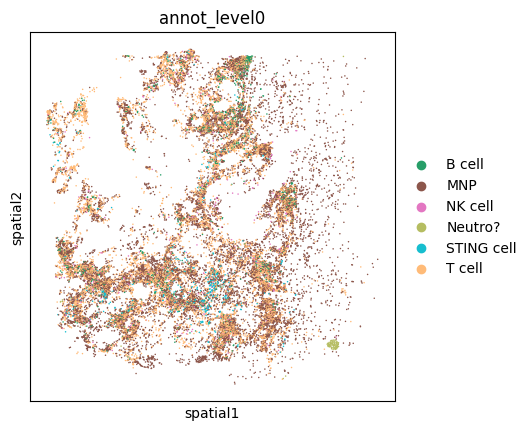

In [23]:
sc.pl.spatial(immune_adata, color="annot_level0", spot_size=200)

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


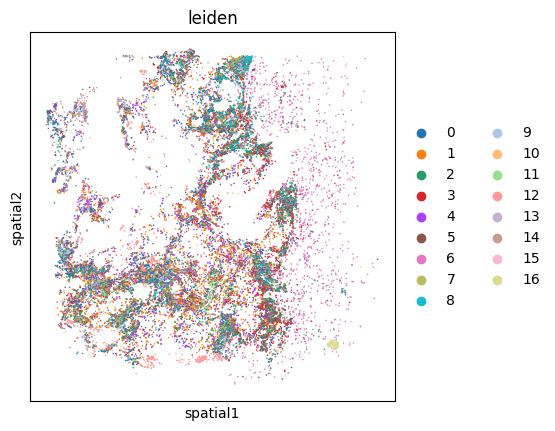

In [25]:
sc.pl.spatial(immune_adata, color="leiden", spot_size=200)

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in

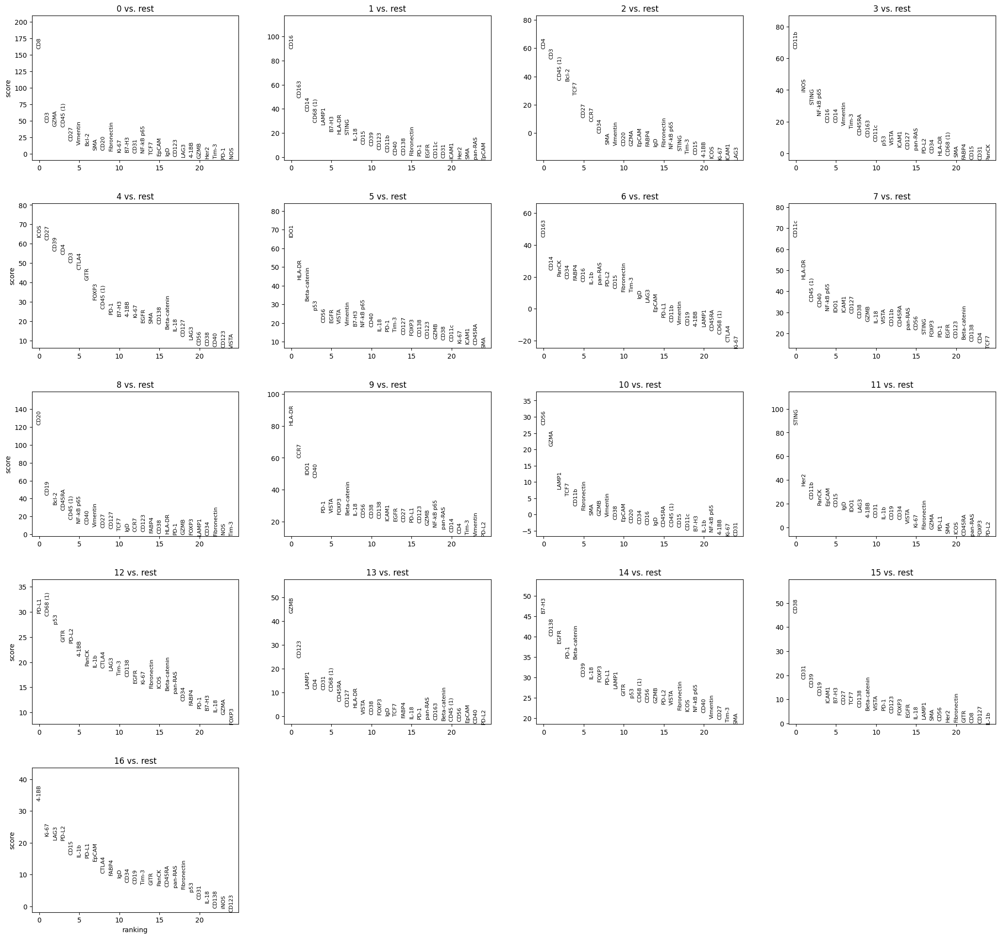

In [26]:
sc.tl.rank_genes_groups(immune_adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(immune_adata, n_genes=25, sharey=False)

In [56]:
immune_adata.obs["annot_level1"] = (
    immune_adata.obs["leiden"]
    .map(lambda x: {"0": "CD8 T cell", "1": "Macrophage", "2": "CD4 T cell","3": "Macrophage",
                    "4": "FOXP3 T cell", "5": "IDO1 Mac","6": "Macrophage","7": "Macrophage","8": "B cell"
                    ,"9": "IL4I1 Mac","10": "NK cell","11": "STING cell","12": "Unkown", 
                    "13": "GZMB T cell","14": "FOXP3 T cell","15":"Plasma cell","16":"RBC/Autofluo"}.get(x, x))
    .astype("category")
)

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


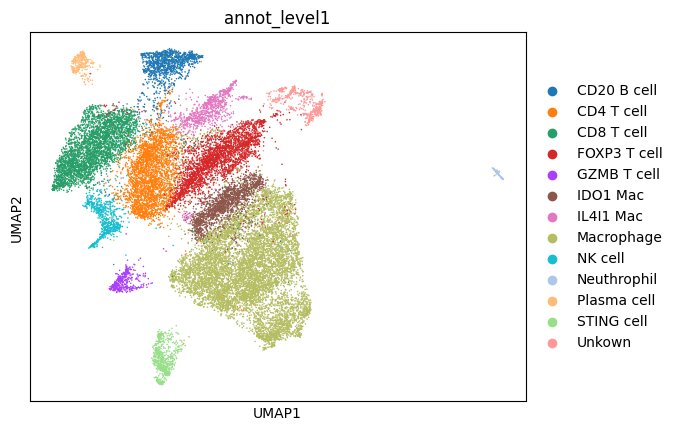

In [28]:
sc.pl.umap(immune_adata, color=["annot_level1"], vmin="p05",vmax="p95")

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in

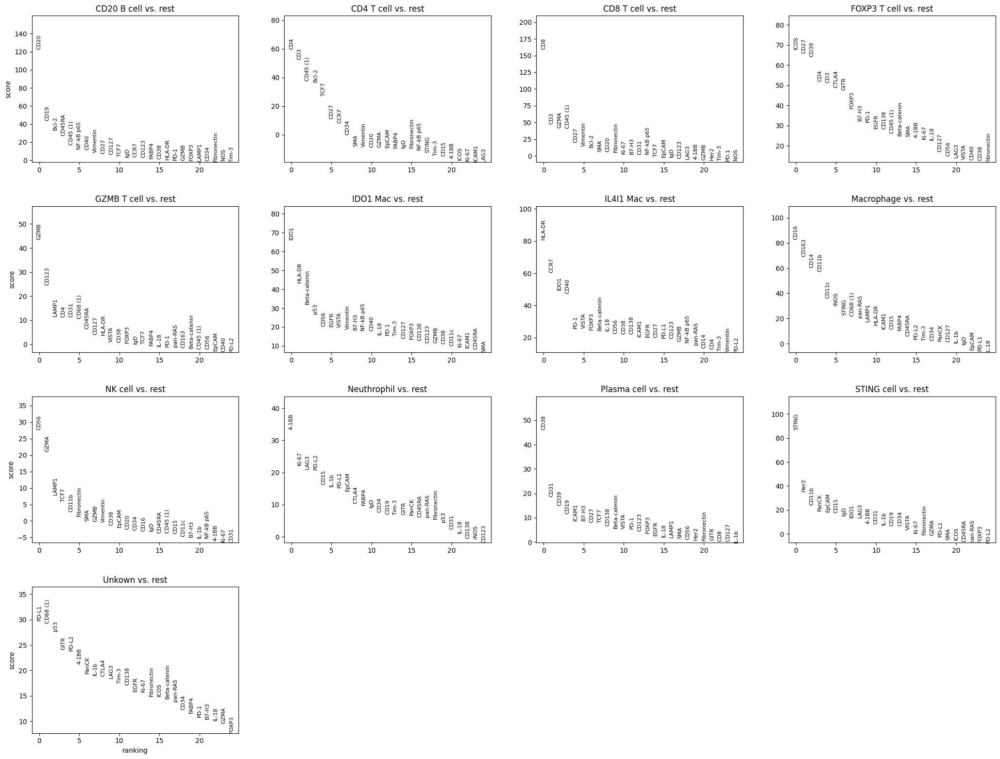

In [29]:
sc.tl.rank_genes_groups(immune_adata, 'annot_level1', method='t-test')
sc.pl.rank_genes_groups(immune_adata, n_genes=25, sharey=False)

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


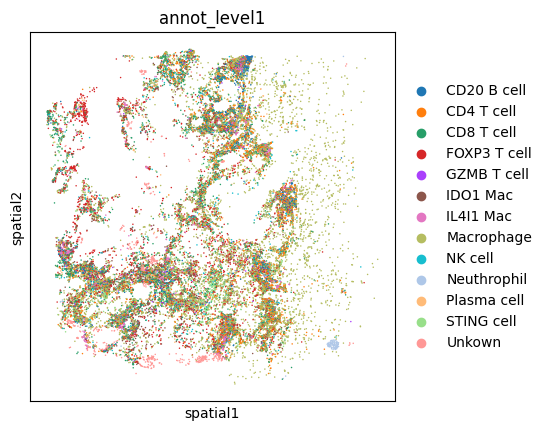

In [31]:
sc.pl.spatial(immune_adata, color="annot_level1", spot_size=200)

Merge annotation

In [58]:
immune_adata.obs["leiden_immune"] = immune_adata.obs["leiden"]
adata.obs["annot_level1"] = adata.obs["annot_level0"]
immune_adata.obs["annot_level1"] = immune_adata.obs["annot_level1"].astype(str)
adata.obs["annot_level1"] = adata.obs["annot_level1"].astype(str)


In [59]:
adata.obs.loc[immune_adata.obs_names,["annot_level1"]] = immune_adata.obs["annot_level1"]

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


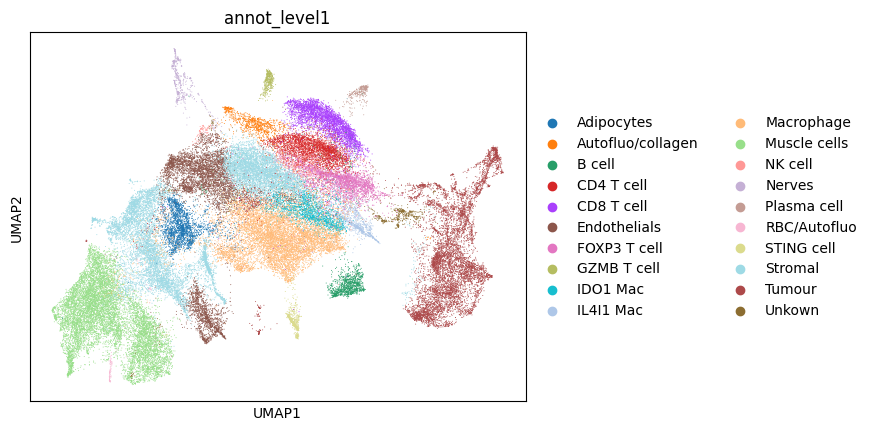

In [60]:
sc.pl.umap(adata, color="annot_level1")

/Users/kmulder/miniforge3/envs/squidpy/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


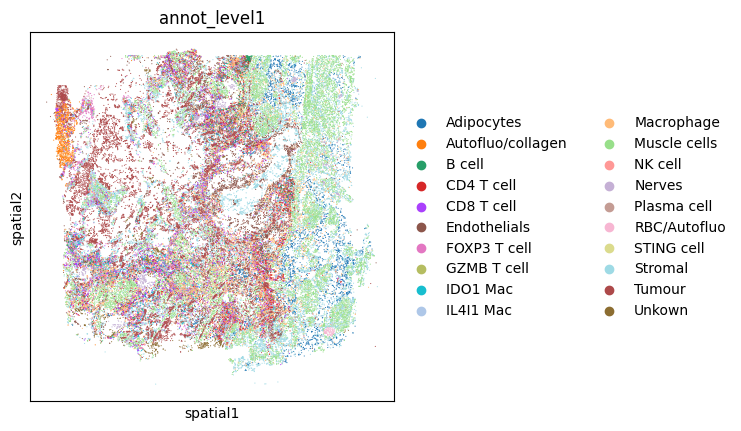

In [61]:
sc.pl.spatial(adata, color="annot_level1", spot_size=150)

In [62]:
adata.write_h5ad("../Prot_sopa/protein_adata/Up_Slide_14_annot.h5ad")